In [1]:
import ast
import os
import inspect
import pandas as pd
import numpy as np
import re

In [2]:
import gensim

In [3]:
from gensim.similarities import SparseMatrixSimilarity, MatrixSimilarity
from collections import defaultdict
from gensim.corpora import Dictionary
from gensim.models import TfidfModel, LsiModel, LdaModel
import math
import gensim.corpora as cp
import matplotlib.pyplot as plt

In [4]:
import smart_open
import random

In [5]:
import itertools 


In [12]:
!python -m pip install -U gensim

In [6]:
from _ast import FunctionDef
from typing import Any


class Visitor(ast.NodeVisitor):

    def __init__(self):
        self.blacklisted_classes = []
        self.data_extracted = {'name' : [], 'file': [], 'line': [], 'type': [], 'comment': []}

    def set_path(self, path):
        self.path = path

    def visit_ClassDef(self, node):
        if not (node.name.startswith('_') or node.name == 'main' or 'test' in node.name.lower()):
            self.data_extracted['name'].append(node.name)
            self.data_extracted['line'].append(node.lineno)
            self.data_extracted['type'].append('class')
            self.data_extracted['file'].append(self.path)
            comment = ast.get_docstring(node)
            if type(comment) == str:
                # self.data_extracted['comment'].append(comment.split('\n', 1)[0])
                self.data_extracted['comment'].append(comment)
            else:
                self.data_extracted['comment'].append('')
            self.generic_visit(node) 
        else:
            self.blacklisted_classes.append(node.name)

    def visit_FunctionDef(self, node):

        if not (node.name in self.blacklisted_classes):

            if not (node.name.startswith('_') or node.name == 'main' or 'test' in node.name.lower()):

                self.data_extracted['name'].append(node.name)
                self.data_extracted['line'].append(node.lineno)
                self.data_extracted['type'].append('function')
                self.data_extracted['file'].append(self.path)
                comment = ast.get_docstring(node)
                if type(comment) == str:
                    # self.data_extracted['comment'].append(comment.split('\n', 1)[0])
                    self.data_extracted['comment'].append(comment)
                else:
                    self.data_extracted['comment'].append('')
                
        

In [7]:
vis = Visitor()

for dirpath, dirnames, filenames in os.walk(r'tensorflow'):
    for file in filenames:
        if file.endswith(".py"):
            with open(os.path.join(dirpath, file)) as f:
                code = f.read()
                node = ast.parse(code)
                path = os.path.join(dirpath, file)
                vis.set_path(path)
                vis.visit(node)
            

In [8]:
# vis.blacklisted_classes

In [9]:
# vis.data_extracted

In [10]:
df = pd.DataFrame(vis.data_extracted)

In [11]:
df

,name,file,line,type,comment
0,UserInputError,tensorflow\configure.py,74,class,
1,is_windows,tensorflow\configure.py,78,function,
2,is_linux,tensorflow\configure.py,82,function,
3,is_macos,tensorflow\configure.py,86,function,
4,is_ppc64le,tensorflow\configure.py,90,function,
...,...,...,...,...,...
11890,find_cuda_config,tensorflow\third_party\gpus\find_cuda_config.py,567,function,Returns a dictionary of CUDA library and heade...
11891,Log,tensorflow\third_party\toolchains\preconfig\ub...,41,function,
11892,GetOptionValue,tensorflow\third_party\toolchains\preconfig\ub...,45,function,Extract the list of values for option from opt...
11893,GetNvccOptions,tensorflow\third_party\toolchains\preconfig\ub...,74,function,Collect the -nvcc_options values from argv.\n\...


In [12]:
# df['name'] = df['name'].str.lower()

In [13]:
# df['comment'] = df['comment'].str.lower()

In [14]:
df.to_csv('data.csv', index=False)

In [15]:
df

,name,file,line,type,comment
0,UserInputError,tensorflow\configure.py,74,class,
1,is_windows,tensorflow\configure.py,78,function,
2,is_linux,tensorflow\configure.py,82,function,
3,is_macos,tensorflow\configure.py,86,function,
4,is_ppc64le,tensorflow\configure.py,90,function,
...,...,...,...,...,...
11890,find_cuda_config,tensorflow\third_party\gpus\find_cuda_config.py,567,function,Returns a dictionary of CUDA library and heade...
11891,Log,tensorflow\third_party\toolchains\preconfig\ub...,41,function,
11892,GetOptionValue,tensorflow\third_party\toolchains\preconfig\ub...,45,function,Extract the list of values for option from opt...
11893,GetNvccOptions,tensorflow\third_party\toolchains\preconfig\ub...,74,function,Collect the -nvcc_options values from argv.\n\...


In [16]:
df1 = df.copy()

In [17]:
# type(df['comment'][0])

In [18]:
df = pd.read_csv("data.csv")  

In [19]:
df

,name,file,line,type,comment
0,UserInputError,tensorflow\configure.py,74,class,NaN
1,is_windows,tensorflow\configure.py,78,function,NaN
2,is_linux,tensorflow\configure.py,82,function,NaN
3,is_macos,tensorflow\configure.py,86,function,NaN
4,is_ppc64le,tensorflow\configure.py,90,function,NaN
...,...,...,...,...,...
11890,find_cuda_config,tensorflow\third_party\gpus\find_cuda_config.py,567,function,Returns a dictionary of CUDA library and heade...
11891,Log,tensorflow\third_party\toolchains\preconfig\ub...,41,function,NaN
11892,GetOptionValue,tensorflow\third_party\toolchains\preconfig\ub...,45,function,Extract the list of values for option from opt...
11893,GetNvccOptions,tensorflow\third_party\toolchains\preconfig\ub...,74,function,Collect the -nvcc_options values from argv.\n\...


In [20]:
# def split_entity_name(name):
#     # Split by camel case
#     words = re.findall(r'[a-zA-Z][a-z]*|[A-Z][a-z]*', name)
    
#     # Split by underscore
#     words = [word.split('_') for word in words]
#     words = sum(words, [])
    
#     return words


In [21]:
def filtered_words(name, stop_words):
    filtered_words = [] 
    # Split by camel case
    words = re.findall(r'[a-zA-Z][a-z]*|[A-Z][a-z]*', name)
    
    # Split by underscore
    words = [word.split('_') for word in words]
    words = sum(words, [])

    # Iterate over the list of words 
    for word in words:
    # If the word is not in the stop word list, add it to the filtered list 
        if word not in stop_words:
            filtered_words.append(word) 
         
    
    return filtered_words


In [22]:
def filtering(name_list, stop_words):
    filtered_words = [] 

    # Iterate over the list of words 
    for word in name_list: 
    # If the word is not in the stop word list, add it to the filtered list 
        if word not in stop_words: 
            filtered_words.append(word)
    return filtered_words


In [23]:
stop_words = ['test', 'tests', 'main', 'this', 'is', 'in', 'to'] 

In [24]:
for i, name in enumerate(df['name']):
    df['name'][i] = filtered_words(name, stop_words)


C:\Users\navde\AppData\Local\Temp/ipykernel_22488/424126417.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['name'][i] = filtered_words(name, stop_words)


In [25]:
# str = "go_to_myHome_is"
# sp = filtered_words(str, stop_words)
# sp

In [26]:
df.replace(np.nan,"", regex=True, inplace=True)

In [27]:
df

,name,file,line,type,comment
0,"[User, Input, Error]",tensorflow\configure.py,74,class,
1,[windows],tensorflow\configure.py,78,function,
2,[linux],tensorflow\configure.py,82,function,
3,[macos],tensorflow\configure.py,86,function,
4,"[ppc, le]",tensorflow\configure.py,90,function,
...,...,...,...,...,...
11890,"[find, cuda, config]",tensorflow\third_party\gpus\find_cuda_config.py,567,function,Returns a dictionary of CUDA library and heade...
11891,[Log],tensorflow\third_party\toolchains\preconfig\ub...,41,function,
11892,"[Get, Option, Value]",tensorflow\third_party\toolchains\preconfig\ub...,45,function,Extract the list of values for option from opt...
11893,"[Get, Nvcc, Options]",tensorflow\third_party\toolchains\preconfig\ub...,74,function,Collect the -nvcc_options values from argv.\n\...


In [28]:
# df['comment'][8].split()

In [29]:
# filtering('Replace old string with new string in file CUDA'.split(), stop_words)

In [30]:
for i, comment in enumerate(df['comment']):
    df['comment'][i] = filtering(comment.split(), stop_words)


C:\Users\navde\AppData\Local\Temp/ipykernel_22488/2430515108.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['comment'][i] = filtering(comment.split(), stop_words)


In [31]:
for i, name in enumerate(df['name']):
    print(i, name)

0 ['User', 'Input', 'Error']
1 ['windows']
2 ['linux']
3 ['macos']
4 ['ppc', 'le']
5 ['cygwin']
6 ['get', 'input']
7 ['symlink', 'force']
8 ['sed', 'place']
9 ['write', 'bazelrc']
10 ['write', 'action', 'env', 'bazelrc']
11 ['run', 'shell']
12 ['cygpath']
13 ['get', 'python', 'path']
14 ['get', 'python', 'major', 'version']
15 ['setup', 'python']
16 ['reset', 'tf', 'configure', 'bazelrc']
17 ['cleanup', 'makefile']
18 ['get', 'var']
19 ['set', 'build', 'var']
20 ['set', 'action', 'env', 'var']
21 ['convert', 'version', 'int']
22 ['check', 'bazel', 'version']
23 ['set', 'cc', 'opt', 'flags']
24 ['set', 'tf', 'cuda', 'clang']
25 ['set', 'tf', 'download', 'clang']
26 ['get', 'from', 'env', 'or', 'user', 'or', 'default']
27 ['set', 'clang', 'cuda', 'compiler', 'path']
28 ['prompt', 'loop', 'or', 'load', 'from', 'env']
29 ['create', 'android', 'ndk', 'rule']
30 ['create', 'android', 'sdk', 'rule']
31 ['get', 'ndk', 'api', 'level']
32 ['set', 'gcc', 'host', 'compiler', 'path']
33 ['reformat'

In [32]:
# df.loc['name', 0] = 'abs'
# df

In [33]:
# for i, name in enumerate(df['name']):
#     df['name'][i] = split_entity_name(name)

In [34]:
list(df['name'])

[['User', 'Input', 'Error'],
 ['windows'],
 ['linux'],
 ['macos'],
 ['ppc', 'le'],
 ['cygwin'],
 ['get', 'input'],
 ['symlink', 'force'],
 ['sed', 'place'],
 ['write', 'bazelrc'],
 ['write', 'action', 'env', 'bazelrc'],
 ['run', 'shell'],
 ['cygpath'],
 ['get', 'python', 'path'],
 ['get', 'python', 'major', 'version'],
 ['setup', 'python'],
 ['reset', 'tf', 'configure', 'bazelrc'],
 ['cleanup', 'makefile'],
 ['get', 'var'],
 ['set', 'build', 'var'],
 ['set', 'action', 'env', 'var'],
 ['convert', 'version', 'int'],
 ['check', 'bazel', 'version'],
 ['set', 'cc', 'opt', 'flags'],
 ['set', 'tf', 'cuda', 'clang'],
 ['set', 'tf', 'download', 'clang'],
 ['get', 'from', 'env', 'or', 'user', 'or', 'default'],
 ['set', 'clang', 'cuda', 'compiler', 'path'],
 ['prompt', 'loop', 'or', 'load', 'from', 'env'],
 ['create', 'android', 'ndk', 'rule'],
 ['create', 'android', 'sdk', 'rule'],
 ['get', 'ndk', 'api', 'level'],
 ['set', 'gcc', 'host', 'compiler', 'path'],
 ['reformat', 'version', 'sequence'],

In [35]:
# stop_words = ['test', 'tests', 'main', 'this', 'is', 'in', 'to'] 
# name_list =  ['write', 'action', 'env', 'to', 'bazelrc']

In [36]:
# def filtering(name_list, stop_words):
#     filtered_words = [] 

#     # Iterate over the list of words 
#     for word in name_list: 
#     # If the word is not in the stop word list, add it to the filtered list 
#         if word not in stop_words: 
#             filtered_words.append(word)
#     return filtered_words


In [37]:

# a = filtering(name_list, stop_words)
# a

In [38]:
# for i, name in enumerate(df['name']):
#     df['name'][i] = filtering(name, stop_words)

In [39]:
list(df['comment'])

[[],
 [],
 [],
 [],
 [],
 [],
 [],
 ['Force',
  'symlink,',
  'equivalent',
  'of',
  "'ln",
  "-sf'.",
  'Args:',
  'target:',
  'items',
  'link',
  'to.',
  'link_name:',
  'name',
  'of',
  'the',
  'link.'],
 ['Replace',
  'old',
  'string',
  'with',
  'new',
  'string',
  'file.',
  'Args:',
  'filename:',
  'string',
  'for',
  'filename.',
  'old:',
  'string',
  'replace.',
  'new:',
  'new',
  'string',
  'replace',
  'to.'],
 [],
 [],
 [],
 ['Convert', 'path', 'from', 'posix', 'windows.'],
 ['Get', 'the', 'python', 'site', 'package', 'paths.'],
 ['Get', 'the', 'python', 'major', 'version.'],
 ['Setup', 'python', 'related', 'env', 'variables.'],
 ['Reset', 'file', 'that', 'contains', 'customized', 'config', 'settings.'],
 ['Delete',
  'any',
  'leftover',
  'BUILD',
  'files',
  'from',
  'the',
  'Makefile',
  'build.',
  'These',
  'files',
  'could',
  'interfere',
  'with',
  'Bazel',
  'parsing.'],
 ['Get',
  'boolean',
  'input',
  'from',
  'user.',
  'If',
  'var_nam

In [40]:
df_2 = df[['name', 'comment']].copy()

In [41]:
df_2

,name,comment
0,"[User, Input, Error]",[]
1,[windows],[]
2,[linux],[]
3,[macos],[]
4,"[ppc, le]",[]
...,...,...
11890,"[find, cuda, config]","[Returns, a, dictionary, of, CUDA, library, an..."
11891,[Log],[]
11892,"[Get, Option, Value]","[Extract, the, list, of, values, for, option, ..."
11893,"[Get, Nvcc, Options]","[Collect, the, -nvcc_options, values, from, ar..."


In [42]:
df_3  = df_2['name'] + df_2['comment']

In [43]:
text = list(df_3)

In [44]:
text

[['User', 'Input', 'Error'],
 ['windows'],
 ['linux'],
 ['macos'],
 ['ppc', 'le'],
 ['cygwin'],
 ['get', 'input'],
 ['symlink',
  'force',
  'Force',
  'symlink,',
  'equivalent',
  'of',
  "'ln",
  "-sf'.",
  'Args:',
  'target:',
  'items',
  'link',
  'to.',
  'link_name:',
  'name',
  'of',
  'the',
  'link.'],
 ['sed',
  'place',
  'Replace',
  'old',
  'string',
  'with',
  'new',
  'string',
  'file.',
  'Args:',
  'filename:',
  'string',
  'for',
  'filename.',
  'old:',
  'string',
  'replace.',
  'new:',
  'new',
  'string',
  'replace',
  'to.'],
 ['write', 'bazelrc'],
 ['write', 'action', 'env', 'bazelrc'],
 ['run', 'shell'],
 ['cygpath', 'Convert', 'path', 'from', 'posix', 'windows.'],
 ['get',
  'python',
  'path',
  'Get',
  'the',
  'python',
  'site',
  'package',
  'paths.'],
 ['get',
  'python',
  'major',
  'version',
  'Get',
  'the',
  'python',
  'major',
  'version.'],
 ['setup', 'python', 'Setup', 'python', 'related', 'env', 'variables.'],
 ['reset',
  'tf',
 

In [45]:
def all_lower(my_list):
    return [[x.lower() for x in list] for list in my_list]

In [46]:
text_lower = all_lower(text)

In [47]:
text_lower

[['user', 'input', 'error'],
 ['windows'],
 ['linux'],
 ['macos'],
 ['ppc', 'le'],
 ['cygwin'],
 ['get', 'input'],
 ['symlink',
  'force',
  'force',
  'symlink,',
  'equivalent',
  'of',
  "'ln",
  "-sf'.",
  'args:',
  'target:',
  'items',
  'link',
  'to.',
  'link_name:',
  'name',
  'of',
  'the',
  'link.'],
 ['sed',
  'place',
  'replace',
  'old',
  'string',
  'with',
  'new',
  'string',
  'file.',
  'args:',
  'filename:',
  'string',
  'for',
  'filename.',
  'old:',
  'string',
  'replace.',
  'new:',
  'new',
  'string',
  'replace',
  'to.'],
 ['write', 'bazelrc'],
 ['write', 'action', 'env', 'bazelrc'],
 ['run', 'shell'],
 ['cygpath', 'convert', 'path', 'from', 'posix', 'windows.'],
 ['get',
  'python',
  'path',
  'get',
  'the',
  'python',
  'site',
  'package',
  'paths.'],
 ['get',
  'python',
  'major',
  'version',
  'get',
  'the',
  'python',
  'major',
  'version.'],
 ['setup', 'python', 'setup', 'python', 'related', 'env', 'variables.'],
 ['reset',
  'tf',
 

In [48]:
corpus_text = [[' '.join(my_list)] for my_list in text_lower]
corpus_text

[['user input error'],
 ['windows'],
 ['linux'],
 ['macos'],
 ['ppc le'],
 ['cygwin'],
 ['get input'],
 ["symlink force force symlink, equivalent of 'ln -sf'. args: target: items link to. link_name: name of the link."],
 ['sed place replace old string with new string file. args: filename: string for filename. old: string replace. new: new string replace to.'],
 ['write bazelrc'],
 ['write action env bazelrc'],
 ['run shell'],
 ['cygpath convert path from posix windows.'],
 ['get python path get the python site package paths.'],
 ['get python major version get the python major version.'],
 ['setup python setup python related env variables.'],
 ['reset tf configure bazelrc reset file that contains customized config settings.'],
 ['cleanup makefile delete any leftover build files from the makefile build. these files could interfere with bazel parsing.'],
 ['get var get boolean input from user. if var_name not set env, ask user enable query_item or not. if the response empty, use the defau

In [49]:
frequency = defaultdict(int)
for text in text_lower:
    for token in text:
        frequency[token] += 1

In [50]:
frequency

defaultdict(int,
            {'user': 151,
             'input': 2271,
             'error': 360,
             'windows': 26,
             'linux': 6,
             'macos': 2,
             'ppc': 1,
             'le': 1,
             'cygwin': 1,
             'get': 1266,
             'symlink': 1,
             'force': 19,
             'symlink,': 1,
             'equivalent': 211,
             'of': 18181,
             "'ln": 1,
             "-sf'.": 1,
             'args:': 3129,
             'target:': 20,
             'items': 63,
             'link': 15,
             'to.': 164,
             'link_name:': 1,
             'name': 2109,
             'the': 38096,
             'link.': 4,
             'sed': 2,
             'place': 34,
             'replace': 69,
             'old': 40,
             'string': 952,
             'with': 5360,
             'new': 560,
             'file.': 242,
             'filename:': 37,
             'for': 8585,
             'filename.': 13,
     

In [51]:
dictionary = Dictionary(text_lower)
print(dictionary)

Dictionary<47982 unique tokens: ['error', 'input', 'user', 'windows', 'linux']...>


In [52]:
dictionary.token2id

{'error': 0,
 'input': 1,
 'user': 2,
 'windows': 3,
 'linux': 4,
 'macos': 5,
 'le': 6,
 'ppc': 7,
 'cygwin': 8,
 'get': 9,
 "'ln": 10,
 "-sf'.": 11,
 'args:': 12,
 'equivalent': 13,
 'force': 14,
 'items': 15,
 'link': 16,
 'link.': 17,
 'link_name:': 18,
 'name': 19,
 'of': 20,
 'symlink': 21,
 'symlink,': 22,
 'target:': 23,
 'the': 24,
 'to.': 25,
 'file.': 26,
 'filename.': 27,
 'filename:': 28,
 'for': 29,
 'new': 30,
 'new:': 31,
 'old': 32,
 'old:': 33,
 'place': 34,
 'replace': 35,
 'replace.': 36,
 'sed': 37,
 'string': 38,
 'with': 39,
 'bazelrc': 40,
 'write': 41,
 'action': 42,
 'env': 43,
 'run': 44,
 'shell': 45,
 'convert': 46,
 'cygpath': 47,
 'from': 48,
 'path': 49,
 'posix': 50,
 'windows.': 51,
 'package': 52,
 'paths.': 53,
 'python': 54,
 'site': 55,
 'major': 56,
 'version': 57,
 'version.': 58,
 'related': 59,
 'setup': 60,
 'variables.': 61,
 'config': 62,
 'configure': 63,
 'contains': 64,
 'customized': 65,
 'file': 66,
 'reset': 67,
 'settings.': 68,
 'tf'

In [53]:
# dictionary = corpora.Dictionary(text_lower)
# dictionary.doc2bow(text)
corpus_bow = [dictionary.doc2bow(text) for text in text_lower]
corpus_bow

[[(0, 1), (1, 1), (2, 1)],
 [(3, 1)],
 [(4, 1)],
 [(5, 1)],
 [(6, 1), (7, 1)],
 [(8, 1)],
 [(1, 1), (9, 1)],
 [(10, 1),
  (11, 1),
  (12, 1),
  (13, 1),
  (14, 2),
  (15, 1),
  (16, 1),
  (17, 1),
  (18, 1),
  (19, 1),
  (20, 2),
  (21, 1),
  (22, 1),
  (23, 1),
  (24, 1),
  (25, 1)],
 [(12, 1),
  (25, 1),
  (26, 1),
  (27, 1),
  (28, 1),
  (29, 1),
  (30, 2),
  (31, 1),
  (32, 1),
  (33, 1),
  (34, 1),
  (35, 2),
  (36, 1),
  (37, 1),
  (38, 5),
  (39, 1)],
 [(40, 1), (41, 1)],
 [(40, 1), (41, 1), (42, 1), (43, 1)],
 [(44, 1), (45, 1)],
 [(46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1)],
 [(9, 2), (24, 1), (49, 1), (52, 1), (53, 1), (54, 2), (55, 1)],
 [(9, 2), (24, 1), (54, 2), (56, 2), (57, 1), (58, 1)],
 [(43, 1), (54, 2), (59, 1), (60, 2), (61, 1)],
 [(40, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 2),
  (68, 1),
  (69, 1),
  (70, 1)],
 [(24, 1),
  (39, 1),
  (48, 1),
  (71, 1),
  (72, 1),
  (73, 1),
  (74, 1),
  (75, 1),
  (76, 1),
  (77, 1),
  (78, 2)

In [54]:
tfidf = TfidfModel(corpus_bow)
# for doc in corpus_bow:
#     print(tfidf[doc])

In [55]:
corpus_tfidf = tfidf[corpus_bow]
for doc in corpus_tfidf:
    print(doc)


[(0, 0.5887055032910421), (1, 0.36776667929148077), (2, 0.7198426911470018)]
[(3, 1.0)]
[(4, 1.0)]
[(5, 1.0)]
[(6, 0.7071067811865476), (7, 0.7071067811865476)]
[(8, 1.0)]
[(1, 0.7064463917113446), (9, 0.7077665544782554)]
[(10, 0.31824812700819377), (11, 0.31824812700819377), (12, 0.04572574832744777), (13, 0.14289443530560667), (14, 0.4528126373433986), (15, 0.18767280829381122), (16, 0.2522538160914915), (17, 0.294740479151423), (18, 0.31824812700819377), (19, 0.06751028918886079), (20, 0.06533203503624166), (21, 0.31824812700819377), (22, 0.31824812700819377), (23, 0.21664976329129754), (24, 0.02614819675372701), (25, 0.15449892299812962)]
[(12, 0.04452704551570304), (25, 0.15044872589510658), (26, 0.13990768617538926), (27, 0.23386167243335118), (28, 0.19155844773368505), (29, 0.039961140510325614), (30, 0.2210054738169019), (31, 0.30990523621621907), (32, 0.19443202457394088), (33, 0.30990523621621907), (34, 0.19757967186791453), (35, 0.36411532189492174), (36, 0.3099052362162190

In [56]:
corpus_tfidf

In [57]:
lsi = LsiModel(corpus_tfidf, id2word=dictionary, num_topics=300)
corpus_lsi = lsi[corpus_tfidf]

In [58]:
corpus_lsi

In [59]:
lsi.print_topics()

[(0,
  '0.746*"config" + 0.612*"get" + 0.105*"the" + 0.066*"from" + 0.065*"of" + 0.063*"a" + 0.037*"if" + 0.036*"for" + 0.034*"shape" + 0.034*"and"'),
 (1,
  '0.415*"the" + 0.254*"of" + 0.243*"a" + -0.218*"config" + 0.173*"call" + 0.154*"if" + 0.140*"for" + 0.138*"and" + 0.135*"be" + 0.132*"="'),
 (2,
  '0.983*"call" + -0.075*"the" + -0.048*"of" + -0.046*"a" + 0.045*"visit" + -0.028*"if" + -0.027*"shape" + -0.026*"=" + -0.025*"and" + -0.025*"be"'),
 (3,
  '0.982*"visit" + 0.066*"def" + 0.065*"while" + 0.056*"assign" + -0.054*"call" + 0.047*"name" + 0.039*"function" + 0.037*"attribute" + 0.035*"lambda" + -0.031*"the"'),
 (4,
  '-0.669*"compute" + -0.521*"output" + -0.475*"shape" + -0.096*"size" + 0.069*"the" + 0.051*"benchmark" + -0.048*"mask" + 0.047*"a" + -0.034*"signature" + 0.029*"value"'),
 (5,
  '0.990*"build" + 0.095*"benchmark" + 0.032*"model" + 0.032*"graph" + 0.029*"p" + 0.028*"u" + 0.023*"compute" + -0.020*"the" + 0.020*"tf" + 0.019*"run"'),
 (6,
  '-0.804*"benchmark" + -0.26

In [60]:
# for doc, as_text in zip(corpus_lsi, corpus_text):
#     print(doc, as_text)

In [61]:
# my_list = ['apple', 'banana', 'cherry']
# result_string = ' '.join(my_list)
# result_string


In [62]:
index_tfidf = SparseMatrixSimilarity(tfidf[corpus_bow], num_features=len(dictionary))

In [63]:
query_document = 'Optimizer that implements the Adadelta algorithm'
query_bow = dictionary.doc2bow(query_document.lower().split())
query_bow

[(24, 1), (70, 1), (2028, 1), (7038, 1), (10834, 1), (20484, 1)]

In [64]:
sims_tfidf = index_tfidf[tfidf[query_bow]]

In [65]:
print(list(enumerate(sims_tfidf)))

[(0, 0.0), (1, 0.0), (2, 0.0), (3, 0.0), (4, 0.0), (5, 0.0), (6, 0.0), (7, 0.0016613507), (8, 0.0), (9, 0.0), (10, 0.0), (11, 0.0), (12, 0.0), (13, 0.003200539), (14, 0.002471671), (15, 0.0), (16, 0.010454582), (17, 0.0016369831), (18, 0.008333107), (19, 0.0028423357), (20, 0.0016618953), (21, 0.007902981), (22, 0.00093531015), (23, 0.0015388882), (24, 0.002332412), (25, 0.0), (26, 0.00286599), (27, 0.0), (28, 0.011950772), (29, 0.0), (30, 0.0), (31, 0.0030047707), (32, 0.0), (33, 0.0028333112), (34, 0.0), (35, 0.0), (36, 0.0), (37, 0.0), (38, 0.0), (39, 0.0), (40, 0.0012959199), (41, 0.0), (42, 0.0), (43, 0.0), (44, 0.0), (45, 0.0), (46, 0.0), (47, 0.0), (48, 0.006356529), (49, 0.0), (50, 0.0), (51, 0.0), (52, 0.0), (53, 0.0), (54, 0.0), (55, 0.0), (56, 0.0), (57, 0.0), (58, 0.0), (59, 0.0), (60, 0.0), (61, 0.0), (62, 0.0), (63, 0.0), (64, 0.0), (65, 0.0), (66, 0.0), (67, 0.0), (68, 0.0), (69, 0.0), (70, 0.0), (71, 0.007380187), (72, 0.0), (73, 0.0), (74, 0.0), (75, 0.0), (76, 0.0), (

In [66]:
for idx, score in sorted(enumerate(sims_tfidf), key=lambda x: x[1], reverse=True)[:5]:
    print(df1['name'].iloc[idx])

AdadeltaOptimizer
Algorithm
Adadelta
Adadelta
benchmark_optimizer


In [67]:
for idx, score in sorted(enumerate(sims_tfidf), key=lambda x: x[1], reverse=True)[:5]:
    print(idx, score)
    print(df1.iloc[idx])

# for idx, score in sorted(enumerate(sims), key=lambda x: x[1], reverse=True):
#     print(score, corpus_text[idx])


10875 0.66881764
name                                       AdadeltaOptimizer
file       tensorflow\tensorflow\python\training\adadelta.py
line                                                      29
type                                                   class
comment    Optimizer that implements the Adadelta algorit...
Name: 10875, dtype: object
8934 0.42086717
name                                               Algorithm
file       tensorflow\tensorflow\python\ops\stateful_rand...
line                                                      67
type                                                   class
comment                                                     
Name: 8934, dtype: object
4831 0.39271683
name                                                Adadelta
file        tensorflow\tensorflow\python\keras\optimizers.py
line                                                     383
type                                                   class
comment    Adadelta optimizer.\n\nAdadelta i

In [68]:
vec_bow = dictionary.doc2bow(query_document.lower().split())
vec_lsi = lsi[tfidf[vec_bow]]
print(vec_lsi)


[(0, 0.012473290779540116), (1, 0.0485764092771376), (2, -0.008737945977313855), (3, -0.0037456046858508935), (4, 0.010448414275358404), (5, -0.0019081195203541304), (6, 0.0038622224677284734), (7, -0.0005866625683619618), (8, 0.005276806890110543), (9, -0.009402690852869773), (10, 0.0024304347769591715), (11, 0.003476914118745535), (12, 0.00848813763836355), (13, -0.007519558394728336), (14, 0.00340849296320697), (15, 0.00705211521100812), (16, 0.01107233915588104), (17, -0.0008212399289421921), (18, -0.006904911920939971), (19, -0.00629318147820913), (20, 0.0008778092356999855), (21, -0.004173104589731051), (22, 0.0047841424148822986), (23, -0.0030622438755266135), (24, 0.007825370523740643), (25, 0.013823925649264343), (26, 0.020602660793622267), (27, 0.004992826208003644), (28, 0.0016385613539383979), (29, -0.0017299218718862782), (30, 0.0028299324693185947), (31, -0.004551657384571071), (32, 0.0044383951634995), (33, -0.004916999620462292), (34, 0.0007163987761345527), (35, -0.002

In [69]:
index_lsi = MatrixSimilarity(corpus_lsi)
sims_lsi = index_lsi[lsi[tfidf[vec_bow]]]
print(list(enumerate(sims_lsi)))

[(0, -0.007961357), (1, -0.014837585), (2, -0.057960887), (3, -0.0093405675), (4, 0.12940624), (5, -0.007638324), (6, -0.008474913), (7, 0.11489472), (8, -0.028170854), (9, -0.03099804), (10, -0.029942326), (11, -0.007947613), (12, -0.025182787), (13, 0.006875314), (14, 0.033003062), (15, 0.03589663), (16, 0.026826192), (17, 0.025174491), (18, 0.030739825), (19, -0.004968623), (20, -0.0072786524), (21, 0.08459239), (22, 0.026471391), (23, 0.07434189), (24, 0.010623891), (25, -0.006977821), (26, -0.008290675), (27, -0.021100566), (28, 0.06755225), (29, -0.02596895), (30, -0.021352936), (31, 0.01678387), (32, -0.019431017), (33, 0.069811314), (34, 0.0029073562), (35, 0.018180622), (36, 0.008686015), (37, 0.013243101), (38, 0.010815393), (39, 0.00619376), (40, 0.032946613), (41, 0.0031806398), (42, 0.022601048), (43, -0.013171643), (44, -0.015700363), (45, -0.033751298), (46, -0.01740349), (47, -0.009449866), (48, 0.07300085), (49, 0.0037158476), (50, 0.0060114237), (51, 0.013632728), (52

In [70]:
# sims = abs(sims)
# sims = sorted(enumerate(sims), key=lambda x: x[1], reverse=True)
# for i, s in sims:
#     print(s, corpus_text[i])

In [71]:
sims_lsi = abs(sims_lsi)
for idx, score in sorted(enumerate(sims_lsi), key=lambda x: x[1], reverse=True)[:5]:
    print(idx, score)
    print(df1.iloc[idx])

3215 0.9397281
name                                       optimizer_jit
file       tensorflow\tensorflow\python\eager\context.py
line                                                1509
type                                            function
comment                                                 
Name: 3215, dtype: object
3216 0.9397281
name                                       optimizer_jit
file       tensorflow\tensorflow\python\eager\context.py
line                                                1515
type                                            function
comment                                                 
Name: 3216, dtype: object
11100 0.9337253
name                                        RMSPropOptimizer
file        tensorflow\tensorflow\python\training\rmsprop.py
line                                                      54
type                                                   class
comment    Optimizer that implements the RMSProp algorith...
Name: 11100, dtype: object


In [72]:
index_bow = SparseMatrixSimilarity(corpus_bow, num_features=len(dictionary))

In [73]:
sims_bow = index_bow[query_bow]

In [74]:
sims_bow

array([0.        , 0.        , 0.        , ..., 0.19462475, 0.29462782,
       0.12751535], dtype=float32)

In [75]:
for idx, score in sorted(enumerate(sims_bow), key=lambda x: x[1], reverse=True)[:5]:
    print(idx, score)
    print(df1.iloc[idx])

10875 0.6285394
name                                       AdadeltaOptimizer
file       tensorflow\tensorflow\python\training\adadelta.py
line                                                      29
type                                                   class
comment    Optimizer that implements the Adadelta algorit...
Name: 10875, dtype: object
10990 0.5103104
name                                GradientDescentOptimizer
file       tensorflow\tensorflow\python\training\gradient...
line                                                      30
type                                                   class
comment    Optimizer that implements the gradient descent...
Name: 10990, dtype: object
11100 0.5
name                                        RMSPropOptimizer
file        tensorflow\tensorflow\python\training\rmsprop.py
line                                                      54
type                                                   class
comment    Optimizer that implements the RMSProp a

In [76]:
# for line in text_lower:
#     line = ' '.join(map(str, line))
#     tokens = gensim.utils.simple_preprocess(line)
#     print(tokens)
    

In [77]:
corpus_text

[['user input error'],
 ['windows'],
 ['linux'],
 ['macos'],
 ['ppc le'],
 ['cygwin'],
 ['get input'],
 ["symlink force force symlink, equivalent of 'ln -sf'. args: target: items link to. link_name: name of the link."],
 ['sed place replace old string with new string file. args: filename: string for filename. old: string replace. new: new string replace to.'],
 ['write bazelrc'],
 ['write action env bazelrc'],
 ['run shell'],
 ['cygpath convert path from posix windows.'],
 ['get python path get the python site package paths.'],
 ['get python major version get the python major version.'],
 ['setup python setup python related env variables.'],
 ['reset tf configure bazelrc reset file that contains customized config settings.'],
 ['cleanup makefile delete any leftover build files from the makefile build. these files could interfere with bazel parsing.'],
 ['get var get boolean input from user. if var_name not set env, ask user enable query_item or not. if the response empty, use the defau

In [78]:
from gensim.test.utils import get_tmpfile

In [79]:
import pickle

In [80]:
def read_corpus(text_corpus, tokens_only=False):
    for i, line in enumerate(text_corpus):
        # print(i, line[0])     
        # line = ' '.join(map(str, line))
        if tokens_only:
            tokens = gensim.utils.simple_preprocess(line)
            yield tokens
        else:
            # For training data, add tags
            tokens = gensim.utils.simple_preprocess(line[0])
            yield gensim.models.doc2vec.TaggedDocument(tokens, [i])

In [81]:
train_corpus = list(read_corpus(corpus_text))

In [82]:
train_corpus

[TaggedDocument(words=['user', 'input', 'error'], tags=[0]),
 TaggedDocument(words=['windows'], tags=[1]),
 TaggedDocument(words=['linux'], tags=[2]),
 TaggedDocument(words=['macos'], tags=[3]),
 TaggedDocument(words=['ppc', 'le'], tags=[4]),
 TaggedDocument(words=['cygwin'], tags=[5]),
 TaggedDocument(words=['get', 'input'], tags=[6]),
 TaggedDocument(words=['symlink', 'force', 'force', 'symlink', 'equivalent', 'of', 'ln', 'sf', 'args', 'target', 'items', 'link', 'to', 'link_name', 'name', 'of', 'the', 'link'], tags=[7]),
 TaggedDocument(words=['sed', 'place', 'replace', 'old', 'string', 'with', 'new', 'string', 'file', 'args', 'filename', 'string', 'for', 'filename', 'old', 'string', 'replace', 'new', 'new', 'string', 'replace', 'to'], tags=[8]),
 TaggedDocument(words=['write', 'bazelrc'], tags=[9]),
 TaggedDocument(words=['write', 'action', 'env', 'bazelrc'], tags=[10]),
 TaggedDocument(words=['run', 'shell'], tags=[11]),
 TaggedDocument(words=['cygpath', 'convert', 'path', 'from', 

In [83]:
line = 'AST Visitor that looks for specific API usage without editing anything'
list(gensim.utils.simple_preprocess(line))

['ast',
 'visitor',
 'that',
 'looks',
 'for',
 'specific',
 'api',
 'usage',
 'without',
 'editing',
 'anything']

In [84]:
test_corpus = list(read_corpus(['AST Visitor that looks for specific API usage without editing anything'], tokens_only=True))
test_corpus

[['ast',
  'visitor',
  'that',
  'looks',
  'for',
  'specific',
  'api',
  'usage',
  'without',
  'editing',
  'anything']]

In [85]:
model = gensim.models.doc2vec.Doc2Vec(vector_size=50, min_count=2, epochs=40)
model.build_vocab(train_corpus)
model.train(train_corpus, total_examples=model.corpus_count, epochs=model.epochs)

In [86]:
test_corpus[0]

['ast',
 'visitor',
 'that',
 'looks',
 'for',
 'specific',
 'api',
 'usage',
 'without',
 'editing',
 'anything']

In [87]:
# filename = 'doc2vec.model'

In [88]:
# model.save(filename)


In [89]:
# model_doc2vec = gensim.models.doc2vec.Doc2Vec.load(filename)


In [90]:
# pickle.dump(model, open(filename, 'wb'))

In [91]:
# fname = get_tmpfile("doc2vec_model")
# model.save(fname)

In [92]:
# model_doc2vec = gensim.models.doc2vec.Doc2Vec.load(get_tmpfile("doc2vec_model"))

In [93]:
# inferred_vector = model_doc2vec.infer_vector(test_corpus[0])
# print(inferred_vector)

In [94]:
# model_doc2vec = pickle.load(open(filename, 'rb'))

In [95]:
inferred_vector = model.infer_vector(test_corpus[0])
print(inferred_vector)

[ 1.3110365e-01 -5.4147322e-02 -2.6786765e-01  8.9562736e-02
 -1.5444575e-01 -2.9232770e-01  1.1612527e-01  6.5903312e-01
 -5.0094314e-02 -4.9595523e-01  2.2448945e-01  1.7730500e-01
  1.0891139e-01  2.2647744e-01 -2.3544683e-01 -1.2953222e-01
  6.5440649e-01 -9.8512366e-02  8.8778809e-02 -7.8113604e-01
  6.8793517e-01  2.7371591e-01  2.2816543e-01 -2.8574780e-01
  4.2448419e-01 -6.0482684e-04  2.1046363e-01 -5.9056263e-02
 -9.5462970e-02  3.7845388e-01 -3.3074197e-01  2.1698575e-01
  4.3023193e-01  2.1336755e-01 -4.0148830e-01  4.6639505e-01
  7.2853929e-01 -2.0669129e-01 -4.1072896e-01 -3.2769164e-01
 -2.3169497e-01 -3.6531723e-01 -3.0208144e-01 -4.2058798e-03
  2.9192036e-01  3.0419257e-02 -3.9621361e-02 -4.9703773e-02
 -7.8950889e-02  6.0168669e-02]


In [96]:
# inferred_vector = model_doc2vec.infer_vector(test_corpus[0])
# print(inferred_vector)

In [97]:
sims_doc2vec = model.dv.most_similar([inferred_vector], topn=len(model.dv))

In [98]:
sims_doc2vec[:5]

[(2215, 0.8092291355133057),
 (10878, 0.8070138096809387),
 (11051, 0.8026055693626404),
 (3693, 0.7954050898551941),
 (6736, 0.7873426675796509)]

In [99]:
# sims_doc2vec = model_doc2vec.dv.most_similar([inferred_vector], topn=len(model_doc2vec.dv))

In [100]:
sims_doc2vec[:5]

[(2215, 0.8092291355133057),
 (10878, 0.8070138096809387),
 (11051, 0.8026055693626404),
 (3693, 0.7954050898551941),
 (6736, 0.7873426675796509)]

In [101]:
for i in list(map(lambda x: x[0], sims_doc2vec[:5])):
    print(df1.iloc[i])

name                                               after_run
file       tensorflow\tensorflow\python\debug\wrappers\ho...
line                                                     219
type                                                function
comment                                                     
Name: 2215, dtype: object
name                                           AdamOptimizer
file           tensorflow\tensorflow\python\training\adam.py
line                                                      32
type                                                   class
comment    Optimizer that implements the Adam algorithm.\...
Name: 10878, dtype: object
name                                               after_run
file       tensorflow\tensorflow\python\training\monitore...
line                                                     844
type                                                function
comment                                                     
Name: 11051, dtype: object
name 

In [102]:
ground_truth_list = []
with open('ground-truth-unique.txt') as f:
    [ground_truth_list.append(line.strip()) for line in f.readlines()]

In [103]:
ground_truth_list = list(filter(None, ground_truth_list))

In [104]:
ground_truth_list

['AST Visitor that looks for specific API usage without editing anything',
 'PastaAnalyzeVisitor',
 './tensorflow/tensorflow/tools/compatibility/ast_edits.py',
 'Convert a TensorShape to a list',
 'TensorShapeProtoToList',
 './tensorflow/tensorflow/python/framework/tensor_util.py',
 'The most basic RNN cell',
 'BasicRNNCell',
 './tensorflow/tensorflow/python/keras/layers/legacy_rnn/rnn_cell_impl.py',
 'Reverses variable length slices',
 'reverse_sequence',
 './tensorflow/tensorflow/python/ops/array_ops.py',
 'Gather gpu device info',
 'gather_gpu_devices',
 './tensorflow/tensorflow/tools/test/gpu_info_lib.py',
 'Extracts a strided slice of a tensor generalized python array indexing',
 'strided_slice',
 './tensorflow/tensorflow/python/ops/array_ops.py',
 'Represents the shape of a Tensor',
 'TensorShape',
 './tensorflow/tensorflow/python/framework/tensor_shape.py',
 'Decorator to define a function with a custom gradient',
 'custom_gradient',
 './tensorflow/tensorflow/python/ops/custom_g

In [105]:
query_list = ground_truth_list[::3]
query_list

['AST Visitor that looks for specific API usage without editing anything',
 'Convert a TensorShape to a list',
 'The most basic RNN cell',
 'Reverses variable length slices',
 'Gather gpu device info',
 'Extracts a strided slice of a tensor generalized python array indexing',
 'Represents the shape of a Tensor',
 'Decorator to define a function with a custom gradient',
 'Layer normalization layer',
 'loss function']

In [106]:
name_list = ground_truth_list[1::3]
name_list

['PastaAnalyzeVisitor',
 'TensorShapeProtoToList',
 'BasicRNNCell',
 'reverse_sequence',
 'gather_gpu_devices',
 'strided_slice',
 'TensorShape',
 'custom_gradient',
 'LayerNormalization',
 'get_loss_function']

In [107]:
file_list = ground_truth_list[2::3]
file_list

['./tensorflow/tensorflow/tools/compatibility/ast_edits.py',
 './tensorflow/tensorflow/python/framework/tensor_util.py',
 './tensorflow/tensorflow/python/keras/layers/legacy_rnn/rnn_cell_impl.py',
 './tensorflow/tensorflow/python/ops/array_ops.py',
 './tensorflow/tensorflow/tools/test/gpu_info_lib.py',
 './tensorflow/tensorflow/python/ops/array_ops.py',
 './tensorflow/tensorflow/python/framework/tensor_shape.py',
 './tensorflow/tensorflow/python/ops/custom_gradient.py',
 './tensorflow/tensorflow/python/keras/layers/normalization.py',
 './tensorflow/tensorflow/python/keras/engine/training_utils.py']

In [108]:
from statistics import mean 


In [166]:
bow_tp = 0
tfidf_tp = 0
lsi_tp = 0
doc2vec_tp = 0

prec_bow = []
prec_tfidf = []
prec_lsi = []
prec_doc2vec = []

for query, name, file in zip(query_list, name_list, file_list):
    tfidf_name = []
    tfidf_file = []
    bow_name = []
    bow_file = []
    lsi_name = []
    lsi_file = []
    doc2vec_name = []
    doc2vec_file = []
    query_bow = dictionary.doc2bow(query.lower().split())
    # print(query)
    sims_tfidf = index_tfidf[tfidf[query_bow]]
    for idx, score in sorted(enumerate(sims_tfidf), key=lambda x: x[1], reverse=True)[:5]:
        tfidf_name.append(df1['name'].iloc[idx])
        tfidf_file.append(df1['file'].iloc[idx])

    sims_lsi = index_lsi[lsi[tfidf[query_bow]]]
    for idx, score in sorted(enumerate(sims_lsi), key=lambda x: x[1], reverse=True)[:5]:
        lsi_name.append(df1['name'].iloc[idx])
        lsi_file.append(df1['file'].iloc[idx])
        
    sims_bow = index_bow[query_bow]
    for idx, score in sorted(enumerate(sims_bow), key=lambda x: x[1], reverse=True)[:5]:
        bow_name.append(df1['name'].iloc[idx])
        bow_file.append(df1['file'].iloc[idx])

    # train_corpus = list(read_corpus(corpus_text))
    test_corpus = list(read_corpus([query.lower()], tokens_only=True))
    inferred_vector = model.infer_vector(test_corpus[0])
    # print(inferred_vector)
    sims_doc2vec = model.dv.most_similar([inferred_vector], topn=len(model.dv))

    for idx in list(map(lambda x: x[0], sims_doc2vec[:5])):
        doc2vec_name.append(df1['name'].iloc[idx])
        doc2vec_file.append(df1['file'].iloc[idx])

    # print(tfidf_name)
    # print(tfidf_file)
    # print(name)
    # print(name in tfidf_name)

    # print(doc2vec_name)
    # print(doc2vec_file)
    # print(name)
    # print(name in doc2vec_name)

    if name in tfidf_name:
        tfidf_tp += 1
        POS = tfidf_name.index(name) + 1
        prec_tfidf.append(1/POS)
    else:
        POS = 0
        prec_tfidf.append(0)

    if name in lsi_name:
        lsi_tp += 1
        POS = lsi_name.index(name) + 1
        prec_lsi.append(1/POS)
    else:
        POS = 0
        prec_lsi.append(0)

    if name in bow_name:
        bow_tp += 1
        POS = bow_name.index(name) + 1
        prec_bow.append(1/POS)
    else:
        POS = 0
        prec_bow.append(0)

    if name in doc2vec_name:
        doc2vec_tp += 1
        POS = doc2vec_name.index(name) + 1
        prec_doc2vec.append(1/POS)
    else:
        POS = 0
        prec_doc2vec.append(0)
    
    # print(POS)

print(prec_tfidf)
print(mean(prec_tfidf))
print(tfidf_tp)
recall_tfidf = tfidf_tp/len(query_list)
print(recall_tfidf)

print(prec_lsi)
print(mean(prec_lsi))
print(lsi_tp)
recall_lsi = lsi_tp/len(query_list)
print(recall_lsi)

print(prec_bow)
print(mean(prec_bow))
print(bow_tp)
recall_bow = bow_tp/len(query_list)
print(recall_bow)

print(prec_doc2vec)
print(mean(prec_doc2vec))
print(doc2vec_tp)
recall_doc2vec = doc2vec_tp/len(query_list)
print(recall_doc2vec)




    # for name, file in zip(name_list, file_list):
    #     if name in tfidf_name and file in tfidf_file:
    #         tfidf_tp += 1
        
    

[1.0, 1.0, 0, 0, 1.0, 0, 0, 0, 0, 0.5]
0.35
4
0.4
[1.0, 0.5, 0, 0, 1.0, 0, 0, 0, 0, 1.0]
0.35
4
0.4
[1.0, 1.0, 0.5, 0, 1.0, 0, 0, 0, 0, 0.25]
0.375
5
0.5
[0, 0.25, 0, 0, 0, 0, 0, 0, 0, 0]
0.025
1
0.1


In [110]:
train_corpus

[TaggedDocument(words=['user', 'input', 'error'], tags=[0]),
 TaggedDocument(words=['windows'], tags=[1]),
 TaggedDocument(words=['linux'], tags=[2]),
 TaggedDocument(words=['macos'], tags=[3]),
 TaggedDocument(words=['ppc', 'le'], tags=[4]),
 TaggedDocument(words=['cygwin'], tags=[5]),
 TaggedDocument(words=['get', 'input'], tags=[6]),
 TaggedDocument(words=['symlink', 'force', 'force', 'symlink', 'equivalent', 'of', 'ln', 'sf', 'args', 'target', 'items', 'link', 'to', 'link_name', 'name', 'of', 'the', 'link'], tags=[7]),
 TaggedDocument(words=['sed', 'place', 'replace', 'old', 'string', 'with', 'new', 'string', 'file', 'args', 'filename', 'string', 'for', 'filename', 'old', 'string', 'replace', 'new', 'new', 'string', 'replace', 'to'], tags=[8]),
 TaggedDocument(words=['write', 'bazelrc'], tags=[9]),
 TaggedDocument(words=['write', 'action', 'env', 'bazelrc'], tags=[10]),
 TaggedDocument(words=['run', 'shell'], tags=[11]),
 TaggedDocument(words=['cygpath', 'convert', 'path', 'from', 

In [111]:
list_corpus_lsi = list(corpus_lsi)

In [178]:
list_corpus_lsi

[[(0, 0.014750031889215568),
  (1, 0.045877321911622804),
  (2, -0.008216353211514529),
  (3, -0.0036925514643601377),
  (4, 0.005468209724471028),
  (5, -0.0010068114248427615),
  (6, 0.005093680393742104),
  (7, 0.0014131637614603256),
  (8, 0.0026635194401143612),
  (9, -0.0052752878994199665),
  (10, -0.012435286975731394),
  (11, 0.0026976431285366236),
  (12, 0.02826444297334155),
  (13, -0.002227428921725757),
  (14, -0.0012884072995252116),
  (15, -0.0035573083879136486),
  (16, 0.013020105379586876),
  (17, -0.006106146437621112),
  (18, 0.005566849031395632),
  (19, 0.004170666401309808),
  (20, 0.01643846231613485),
  (21, 0.012528333722423499),
  (22, -0.01219230535287097),
  (23, -0.00450952858622897),
  (24, 0.021216338494774716),
  (25, -0.04663869702656301),
  (26, 0.01588420980507212),
  (27, -0.007848262181578842),
  (28, -0.018214640631758258),
  (29, -0.00721946738205101),
  (30, 0.019482154377352397),
  (31, 0.005865017846854297),
  (32, -0.007192201223567289),
  (

In [134]:
from sklearn.manifold import TSNE

In [151]:
col_c = np.repeat(np.linspace(0, 9, 10), 6)
col_c.shape

(60,)

In [163]:
inferred_vectors_lsi

[[(0, 0.008102002083334045),
  (1, 0.03129806629159488),
  (2, -0.005193544985407523),
  (3, 0.0010307361267164685),
  (4, 0.007380089295416027),
  (5, -0.0006839346535563008),
  (6, 0.001936039040860229),
  (7, 0.0012918090188931731),
  (8, 0.0004647713733368264),
  (9, -0.003796052564179983),
  (10, -0.0041872381694521826),
  (11, -0.0010946983594312919),
  (12, 0.002548917525508299),
  (13, -0.002650227339568516),
  (14, 0.003109018549054019),
  (15, 0.004187910167429086),
  (16, 0.007111157842833299),
  (17, 0.0017801072974319699),
  (18, -0.007955869549742919),
  (19, -0.007528316932025313),
  (20, 0.006802824920332095),
  (21, -0.002384095171759586),
  (22, 0.009207490117148127),
  (23, -0.005850971994919158),
  (24, 0.007675321870832225),
  (25, 0.004243022873066975),
  (26, 0.01180340039094344),
  (27, 0.0004930355937382144),
  (28, 0.0008243824363923467),
  (29, 0.0011849710091054867),
  (30, -0.0007166065914537736),
  (31, -0.012785512891875768),
  (32, 0.004835271220267079),

In [156]:
np.array(inferred_vectors_lsi).shape

(60, 300, 2)

In [185]:
vect

array([[ 0.008102  ,  0.03129807, -0.00519354, ...,  0.00085376,
         0.02313681,  0.01889648],
       [ 0.01425159,  0.05779921, -0.01008449, ...,  0.00120948,
         0.01901579,  0.01141055],
       [ 0.00138236,  0.00561324, -0.00013162, ..., -0.00693008,
         0.03673707,  0.01222706],
       ...,
       [ 0.00964555,  0.02951946, -0.00539933, ..., -0.00215882,
         0.01513284,  0.00674086],
       [ 0.02610907,  0.08401333, -0.0142241 , ..., -0.01124641,
        -0.00586946, -0.01000555],
       [ 0.0268406 ,  0.09989205, -0.01789794, ..., -0.01435794,
         0.00501532, -0.00178475]])

c:\Users\navde\anaconda3\envs\torch\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\navde\anaconda3\envs\torch\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 7 nearest neighbors...
[t-SNE] Indexed 60 samples in 0.001s...
[t-SNE] Computed neighbors for 60 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 60 / 60
[t-SNE] Mean sigma: 0.086399
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.462387
[t-SNE] KL divergence after 900 iterations: 1.164135


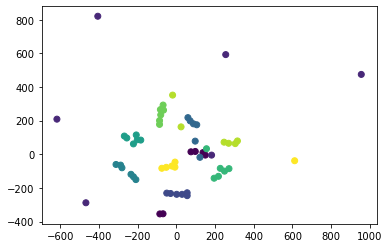

In [152]:
vect = np.array(inferred_vectors_lsi)[:, :, 1].reshape(np.array(inferred_vectors_lsi).shape[0], np.array(inferred_vectors_lsi).shape[1])
tsne = TSNE(n_components=2, verbose=1, perplexity=2, n_iter=3000)
tsne_red = tsne.fit_transform(vect)
plt.scatter(tsne_red[:, 0], tsne_red[:, 1], c = col_c)

In [182]:
np.array(inferred_vectors_doc2vec)

array([[ 0.08160577, -0.11530408, -0.20124407, ..., -0.11060076,
         0.01445192,  0.08866013],
       [ 0.40548933,  0.00869325, -0.23500702, ..., -0.1781327 ,
        -0.07817286,  0.11878868],
       [ 0.24246375, -0.05619256, -0.24203645, ..., -0.16381562,
        -0.08928204,  0.03677997],
       ...,
       [ 0.15236692,  0.01553844, -0.10152075, ..., -0.04812003,
        -0.2867893 ,  0.09057506],
       [ 0.64407736,  0.2620432 , -0.5366578 , ..., -0.27594352,
        -0.44410688, -0.01748248],
       [ 0.36339614, -0.00385778, -0.1810685 , ..., -0.14564805,
        -0.52423465,  0.11309105]], dtype=float32)

In [164]:
inferred_vectors_doc2vec

[array([ 0.08160577, -0.11530408, -0.20124407,  0.14774348, -0.28219828,
        -0.43459645,  0.28089538,  0.74267346, -0.06532648, -0.5696852 ,
         0.20675562,  0.161018  ,  0.03415349,  0.13335946, -0.29296246,
        -0.33515579,  0.6832186 , -0.3926039 ,  0.08074903, -0.8322809 ,
         0.69189024,  0.2050035 ,  0.21395153, -0.2684089 ,  0.35785407,
         0.01601273,  0.29090455,  0.04527039, -0.16403648,  0.3633245 ,
        -0.4333647 ,  0.32275176,  0.21759695,  0.19120914, -0.25264603,
         0.5646249 ,  0.7917716 , -0.02740711, -0.254578  , -0.3263273 ,
        -0.30074093, -0.3583752 , -0.26076335, -0.06931549,  0.29016724,
         0.04125202, -0.09998193, -0.11060076,  0.01445192,  0.08866013],
       dtype=float32),
 array([ 0.40548933,  0.00869325, -0.23500702, -0.04456052, -0.08501434,
        -0.40070787,  0.06706452,  0.41669443,  0.06375253, -0.18752451,
         0.08456843,  0.17468747,  0.14686877,  0.07988805, -0.41166976,
        -0.38153937,  0.333

In [175]:
len(tsne_red_doc)

60

In [205]:
6%6

0

In [194]:
tsne_red

array([[  97.7913   ,   16.447548 ],
       [  75.46356  ,   14.335809 ],
       [ -68.7949   , -354.08188  ],
       [ -85.327126 , -354.90845  ],
       [ 137.56798  ,    9.6010685],
       [ 149.76341  ,   -5.100196 ],
       [-617.0862   ,  208.46375  ],
       [ 955.4997   ,  474.50662  ],
       [-467.3491   , -288.56744  ],
       [-405.90485  ,  820.35443  ],
       [ 182.02463  ,   -5.2503643],
       [ 255.11923  ,  592.32117  ],
       [   1.6238073, -238.3329   ],
       [  55.938118 , -246.32597  ],
       [  55.806145 , -229.21057  ],
       [  29.427803 , -238.47092  ],
       [ -49.591564 , -231.21184  ],
       [ -29.726152 , -233.44249  ],
       [  97.38553  ,   77.837036 ],
       [  88.27395  ,  180.77374  ],
       [ 105.371735 ,  175.07556  ],
       [  59.765285 ,  217.57977  ],
       [ 121.80313  ,  -18.45578  ],
       [  71.55063  ,  198.12796  ],
       [-209.10301  , -150.80751  ],
       [-221.42809  , -134.28972  ],
       [-234.40427  , -119.410385 ],
 

In [208]:
tsne_red_doc

array([[ -38.43155  ,  229.46057  ],
       [ -49.958115 ,  211.7811   ],
       [ 102.00033  , -167.46977  ],
       [-160.35616  ,   76.58223  ],
       [-192.01753  ,   47.162743 ],
       [ 102.52556  , -181.42299  ],
       [ 363.66748  ,  183.82999  ],
       [ 350.23773  ,  208.40051  ],
       [ 363.81396  ,  160.6881   ],
       [ -13.128551 ,  181.0636   ],
       [ 383.95084  ,  190.65486  ],
       [ 322.9686   ,  192.30925  ],
       [ -78.93179  ,  225.63646  ],
       [ 175.14577  ,  -79.68545  ],
       [-203.73503  ,   69.44803  ],
       [ 141.83179  ,  -99.74914  ],
       [ -44.146713 ,  188.99815  ],
       [ 161.90015  ,  -86.8385   ],
       [ -67.966156 ,  160.4556   ],
       [ -80.585686 ,  189.40303  ],
       [ -34.136982 ,  169.60118  ],
       [ 210.13124  ,   -6.590764 ],
       [ -58.36131  ,  191.40419  ],
       [ 198.16618  ,  -23.917414 ],
       [ 221.88937  , -118.205124 ],
       [-138.3577   ,  195.96434  ],
       [-135.26512  ,  179.612    ],
 

c:\Users\navde\anaconda3\envs\torch\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\navde\anaconda3\envs\torch\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 7 nearest neighbors...
[t-SNE] Indexed 60 samples in 0.001s...
[t-SNE] Computed neighbors for 60 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 60 / 60
[t-SNE] Mean sigma: 0.150205
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.026749
[t-SNE] KL divergence after 2800 iterations: 0.539672


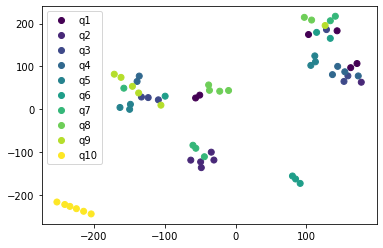

In [217]:
tsne = TSNE(n_components=2, verbose=1, perplexity=2, n_iter=3000)
tsne_red_doc = tsne.fit_transform(np.array(inferred_vectors_doc2vec))

# plt.scatter(tsne_red_doc[:, 0], tsne_red_doc[:, 1], c = col_c )
# plt.legend(['q1', 'q2', 'q3', 'q4', 'q5', 'q6', 'q7', 'q8', 'q9', 'q10'])

# plt.show()


scatter = plt.scatter(tsne_red_doc[:, 0], tsne_red_doc[:, 1], c = col_c )
handles, _ = scatter.legend_elements(prop='colors')
labels = ['q1', 'q2', 'q3', 'q4', 'q5', 'q6', 'q7', 'q8', 'q9', 'q10']
plt.legend(handles, labels)


In [124]:
inferred_vectors_lsi = []
inferred_vectors_doc2vec = []

for query, name, file in zip(query_list, name_list, file_list):
    print(query)
    query_bow = dictionary.doc2bow(query.lower().split())
    print(lsi[tfidf[query_bow]])
    inferred_vectors_lsi.append(lsi[tfidf[query_bow]])
    sims_lsi = index_lsi[lsi[tfidf[query_bow]]]
    sims_lsi = abs(sims_lsi)
    for idx, score in sorted(enumerate(sims_lsi), key=lambda x: x[1], reverse=True)[:5]:
        # print(df1.iloc[idx])
        # print(idx, score)
        print(list_corpus_lsi[idx])
        inferred_vectors_lsi.append(list_corpus_lsi[idx])
    test_corpus = list(read_corpus([query.lower()], tokens_only=True))
    # print(test_corpus[0])
    query_vector_doc2vec = model.infer_vector(test_corpus[0])
    print(query_vector_doc2vec)
    inferred_vectors_doc2vec.append(query_vector_doc2vec)
    # print(inferred_vector)
    # inferred_vectors_doc2vec.append(inferred_vector_doc2vec)
    sims_doc2vec = model.dv.most_similar([query_vector_doc2vec], topn=len(model.dv))
    for idx in list(map(lambda x: x[0], sims_doc2vec[:5])):
        print(model.infer_vector(train_corpus[idx][0]))
        inferred_vectors_doc2vec.append(model.infer_vector(train_corpus[idx][0]))

AST Visitor that looks for specific API usage without editing anything
[(0, 0.008102002083334045), (1, 0.03129806629159488), (2, -0.005193544985407523), (3, 0.0010307361267164685), (4, 0.007380089295416027), (5, -0.0006839346535563008), (6, 0.001936039040860229), (7, 0.0012918090188931731), (8, 0.0004647713733368264), (9, -0.003796052564179983), (10, -0.0041872381694521826), (11, -0.0010946983594312919), (12, 0.002548917525508299), (13, -0.002650227339568516), (14, 0.003109018549054019), (15, 0.004187910167429086), (16, 0.007111157842833299), (17, 0.0017801072974319699), (18, -0.007955869549742919), (19, -0.007528316932025313), (20, 0.006802824920332095), (21, -0.002384095171759586), (22, 0.009207490117148127), (23, -0.005850971994919158), (24, 0.007675321870832225), (25, 0.004243022873066975), (26, 0.01180340039094344), (27, 0.0004930355937382144), (28, 0.0008243824363923467), (29, 0.0011849710091054867), (30, -0.0007166065914537736), (31, -0.012785512891875768), (32, 0.00483527122026

In [125]:
inferred_vectors_lsi

[[(0, 0.008102002083334045),
  (1, 0.03129806629159488),
  (2, -0.005193544985407523),
  (3, 0.0010307361267164685),
  (4, 0.007380089295416027),
  (5, -0.0006839346535563008),
  (6, 0.001936039040860229),
  (7, 0.0012918090188931731),
  (8, 0.0004647713733368264),
  (9, -0.003796052564179983),
  (10, -0.0041872381694521826),
  (11, -0.0010946983594312919),
  (12, 0.002548917525508299),
  (13, -0.002650227339568516),
  (14, 0.003109018549054019),
  (15, 0.004187910167429086),
  (16, 0.007111157842833299),
  (17, 0.0017801072974319699),
  (18, -0.007955869549742919),
  (19, -0.007528316932025313),
  (20, 0.006802824920332095),
  (21, -0.002384095171759586),
  (22, 0.009207490117148127),
  (23, -0.005850971994919158),
  (24, 0.007675321870832225),
  (25, 0.004243022873066975),
  (26, 0.01180340039094344),
  (27, 0.0004930355937382144),
  (28, 0.0008243824363923467),
  (29, 0.0011849710091054867),
  (30, -0.0007166065914537736),
  (31, -0.012785512891875768),
  (32, 0.004835271220267079),

In [126]:
inferred_vectors_doc2vec

[array([ 0.08160577, -0.11530408, -0.20124407,  0.14774348, -0.28219828,
        -0.43459645,  0.28089538,  0.74267346, -0.06532648, -0.5696852 ,
         0.20675562,  0.161018  ,  0.03415349,  0.13335946, -0.29296246,
        -0.33515579,  0.6832186 , -0.3926039 ,  0.08074903, -0.8322809 ,
         0.69189024,  0.2050035 ,  0.21395153, -0.2684089 ,  0.35785407,
         0.01601273,  0.29090455,  0.04527039, -0.16403648,  0.3633245 ,
        -0.4333647 ,  0.32275176,  0.21759695,  0.19120914, -0.25264603,
         0.5646249 ,  0.7917716 , -0.02740711, -0.254578  , -0.3263273 ,
        -0.30074093, -0.3583752 , -0.26076335, -0.06931549,  0.29016724,
         0.04125202, -0.09998193, -0.11060076,  0.01445192,  0.08866013],
       dtype=float32),
 array([ 0.40548933,  0.00869325, -0.23500702, -0.04456052, -0.08501434,
        -0.40070787,  0.06706452,  0.41669443,  0.06375253, -0.18752451,
         0.08456843,  0.17468747,  0.14686877,  0.07988805, -0.41166976,
        -0.38153937,  0.333

In [116]:
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns


In [179]:
# TSNE
tsne_vectors = np.array(inferred_vectors_doc2vec)


In [181]:
tsne_vectors.shape

(60, 50)

In [114]:
tsne = TSNE(n_components=2, verbose=1, perplexity=2, n_iter=3000)


In [115]:
tsne_results = tsne.fit_transform(tsne_vectors)
df_tsne = pd.DataFrame(columns=['tsne-2d-one', 'tsne-2d-two', 'vec'])


c:\Users\navde\anaconda3\envs\torch\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\navde\anaconda3\envs\torch\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 7 nearest neighbors...
[t-SNE] Indexed 10 samples in 0.000s...
[t-SNE] Computed neighbors for 10 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 10 / 10
[t-SNE] Mean sigma: 0.224838
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.825157
[t-SNE] KL divergence after 950 iterations: 0.390205


C:\Users\navde\AppData\Local\Temp/ipykernel_9884/2941228815.py:5: UserWarning: 
The palette list has fewer values (5) than needed (10) and will cycle, which may produce an uninterpretable plot.
  ax = sns.scatterplot(


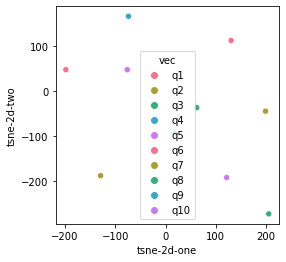

In [118]:
df_tsne['tsne-2d-one'] = tsne_results[:, 0]
df_tsne['tsne-2d-two'] = tsne_results[:, 1]
df_tsne['vec'] = ['q1', 'q2', 'q3', 'q4', 'q5', 'q6', 'q7', 'q8', 'q9', 'q10']
plt.figure(figsize=(4, 4))
ax = sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue="vec",
    palette=sns.color_palette("husl", n_colors=5),
    data=df_tsne,
    legend="full",
    alpha=1.0
)

